# load packages

In [1]:
DATA_DIR = '/data/peer/wallet/Jupyter/2021_SPADE/2021_Zhang_BRCA/'

In [2]:
# import packages 
import scanpy as sc
import scanpy.external as sce
import anndata as anndata
from anndata import AnnData
import time
import os
import numpy as np
import seaborn as sns
import pandas as pd
import re
import h5py
import scipy
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from matplotlib.colors import LinearSegmentedColormap
import matplotlib.patches as patches
import matplotlib.colors as colors
import matplotlib.font_manager

# other packages
import glob
from collections import OrderedDict
from scipy.sparse import csr_matrix
#import diffxpy.api as de
from scanpy.external.pp import magic
from scipy.stats import zscore
import scipy.cluster.hierarchy as hc
from statistics import median
import math
from typing import Union
import phenograph
import numpy.matlib

from kneed import KneeLocator


In [ ]:
#custom libraries
from scrnaseq_preprocessing_utils import *

In [6]:
#set style
sns.set_style('white')
# define colors
color_map_clusters_nogrey = ["#FFFF00", "#1CE6FF", "#FF34FF", "#FF4A46", "#008941", "#006FA6", "#A30059", "#7A4900", "#0000A6", "#63FFAC", "#B79762", "#004D43", "#8FB0FF", "#997D87",
"#5A0007", "#809693", "#1B4400", "#4FC601", "#3B5DFF", "#4A3B53", "#FF2F80",
"#61615A", "#BA0900", "#6B7900", "#00C2A0", "#FFAA92", "#FF90C9", "#B903AA", "#D16100",
"#DDEFFF", "#000035", "#7B4F4B", "#A1C299", "#300018", "#0AA6D8", "#013349", "#00846F",
"#372101", "#FFB500", "#C2FFED", "#A079BF", "#CC0744", "#C0B9B2", "#C2FF99", "#001E09",
"#00489C", "#6F0062", "#0CBD66", "#EEC3FF", "#456D75", "#B77B68", "#7A87A1", "#788D66",
"#885578", "#FAD09F", "#FF8A9A", "#D157A0", "#BEC459", "#456648", "#0086ED", "#886F4C",
"#34362D", "#B4A8BD", "#00A6AA", "#452C2C", "#636375", "#A3C8C9", "#FF913F", "#938A81",
"#575329", "#00FECF", "#B05B6F", "#8CD0FF", "#3B9700", "#04F757", "#C8A1A1", "#1E6E00",
"#7900D7", "#A77500", "#6367A9", "#A05837", "#6B002C", "#772600", "#D790FF", "#9B9700",
"#549E79", "#FFF69F", "#201625", "#72418F", "#BC23FF", "#99ADC0", "#3A2465", "#922329",
"#5B4534", "#FDE8DC", "#404E55", "#0089A3", "#CB7E98", "#A4E804", "#324E72", "#6A3A4C"]

blue_red = ['#0E518F','#DF480F']

subtype_color_dict = {'TAM':'#FFFF00',
                 'DC_cDC2A':'#1CE6FF',
                 'pDC':'#FF34FF',
                 'M-MDC':'#FF4A46',
                 'mono_c':'#008941',
                 'mast':'#006FA6',
                      'TAM_TRMac':'#456D75',
                 'DC_cDC1':'#A30059',
                 'Gr-MDC':'#7A4900',
                 'DC_Langerhans':'#0000A6',
                      'DC_AXLpos_ITGAXpos':'#0CBD66',
                      'DC_FDC_PTPRCpos':'#EEC3FF',
                'DC_cDC3':'#63FFAC',
                'CD8_T':'#B79762',
                'Treg':'#004D43',
                'CD4_T':'#8FB0FF',
                'CD8_T':'#997D87',
                 'NK':'#5A0007',
                 'gdT':'#809693',
                    'ILC3':'#7900D7',
                       'CD8_T_KLRG1pos_effector_preexhausted':'#4FC601',
                 'CD4_T_naive':'#3B5DFF',
                 'CD4_T_TH1':'#4A3B53',
                 'CD8_T_TRM':'#FF2F80',
                'CD8_T_TRM_exhausted':'#61615A',
                 'CD8_T_naive':'#BA0900',
                 'CD8_T_KLRG1pos_effector_preexhausted':'#6B7900',
             'CD4_T_naive_low_libsize':'#00C2A0',
                 'CD8_T_naive':'#FFAA92',
             'NK_CD56bright':'#FF90C9',
                 'CD8_T_TEM_effector_progen_exhausted':'#B903AA',
            'gdT':'#D16100',
              'CD8_T_KLRG1pos_effector_nonexhausted':'#DDEFFF',
              'CD8_T_TRM_exhausted_proliferating':'#000035',
            'CD4_T_TH1_proliferating':'#7B4F4B',
               'NK_CD56dim':'#A1C299',
               'Treg':'#300018',
                  'CD8_T_KLRG1pos_effector_preexhausted':'#0AA6D8',
                         'MDC':'#013349',
                 'DC':'#00846F',
                'mixed_T_M':'#636375',
                        'B_memory':'#372101',
                
                 'B_naive':'#FFB500',
                'plasma':'#C2FFED',
                'B_GC':'#A079BF',
                    'B_memory_switched':'#CC0744',
                'plasma_IgA':'#C0B9B2',
                 'B_memory_double_neg':'#C2FF99',
               'plasma_IgG':'#001E09',
                'plasmablast':'#00489C',
               'plasma_Be1':'#6F0062',
                     'M':'#B77B68',
                     'TNK':'#7A87A1',
                     'B':'#788D66',
                     'TAM_MKlike':'#885578',
                     'mono':'#34362D',
                     'mono_c':'#B4A8BD',
                     'mono_nc':'#00A6AA',
                     'ILC1':'#452C2C',
                     'CD4_T_TFH':'#A3C8C9',
                     'CD4_T_TFH_exhausted-progenitor':'#FF913F',
                     'CD4_T_TSCM':'#938A81',
                     'CD8_T_KLRG1neg_effector_preexhausted':'#575329',
                     'CD8_T_KLRG1pos_effector_exhausted':'#00FECF',
                     'CD8_T_TRM_nonexhausted':'#B05B6F',
                     'CD8_T_innate-like':'#8CD0FF',
                     'TNK_proliferating':'#3B9700',
                     'NK_CD56dim_proliferating':'#04F757',
                     'T':'#C8A1A1',
                     'T_proliferating':'#1E6E00',
                     'B_memory':"#BC23FF",
                      'B_naive':"#A77500",
                      'plasma':"#6367A9",
                 'B_GC':"#A05837",
                      'B_memory_switched':"#6B002C",
                 'B_naive':"#772600",
              'plasma_IgA':"#D790FF",
                'B_memory_double_neg':"#9B9700",
               'plasma_IgG':"#549E79",
                 'plasmablast':"#FFF69F",
                'plasma_IgG':"#201625",
                 'plasma_Be1':"#72418F",
                      'B':"#922329", 
                      'TNK':"#99ADC0",
                      'M': "#3A2465",
                      'nan':'#FFFFFF',
                      'B_GC_proliferating':'#5B4534',
                      'B_memory_switched_Be1':'#FDE8DC',
                      'B_memory_switched_proliferating':'#404E55',
                      'plasma_IgG_Be1':'#0089A3',
                       'B_proliferating':'#CB7E98'
                }

perturbation_map = ['#EFD060','#0289DE','#0289DE','#DCA6C4']
stage_map = ['#EFD060','#0289DE','#67C6F8','#DCA6C4']
stage_map_2 = ['#EFD060','#0289DE','#DCA6C4']
perturbation_stage_map_2 = ['#F95957', '#FF0300','#EFD060','#0289DE','#0289DE','#DCA6C4','#EFD060','#0289DE','#DCA6C4']
perturbation_stage_map = ['#F95957', '#FF0300','#e1e1e1','#e1e1e1','#e1e1e1','#e1e1e1', '#EFD060','#0289DE','#DCA6C4']
color_map_clusters_plt = cm = LinearSegmentedColormap.from_list(
        'color_map_clusters', color_map_clusters)

#scanpy layout
sc.set_figure_params(scanpy=True, dpi=400, dpi_save=400, frameon=False, vector_friendly=True, fontsize=7, figsize=None, color_map=None, format='pdf', facecolor=None, transparent=True, ipython_format='png2x')
sns.set_style('white')

# Annotate cells

## map annotations to anndata scran normalized on all samples and raw anndata element

In [15]:

adata_path = DATA_DIR +'TIL-X-BRCA-X-Zhang-X-2021-X-all_cells_raw_annotated_clustered_nodrops_nodoub_tumor_scran_labeled_clustered_annotated_211208.h5ad' #'TIL-X-BRCA-X-Zhang-X-2021-X-all_cells_raw_annotated_clustered_nodrops_nodoub_tumor_scran_labeled_clustered.h5ad'
adata_save_path = DATA_DIR + 'TIL-X-BRCA-X-Zhang-X-2021-X-all_cells_raw_annotated_clustered_nodrops_nodoub_tumor_scran_labeled_clustered_annotated_211208.h5ad'

#annotations
adata_B_path = DATA_DIR + 'TIL-X-BRCA-X-Zhang-X-2021-X-B_scran_plus_raw_10k-hv_annotated.h5ad'
adata_M_path = DATA_DIR + 'TIL-X-BRCA-X-Zhang-X-2021-X-M_scran_plus_raw_annotated_high-quality-cells.h5ad'
adata_TNK_path = DATA_DIR + 'TIL-X-BRCA-X-Zhang-X-2021-X-TNK_scran_plus_raw.h5ad'


adata_paths = [adata_B_path, adata_M_path, adata_TNK_path] 

make_raw= False


In [17]:
#load adata
adata = sc.read(adata_path)
adata_annotations = []

for i in adata_paths:
    adata_subset = sc.read(i)
    adata_annotations.append(adata_subset)
    del adata_subset

adata.obs_names #check whether format is barcode_sampleid

Index(['AAACCTGAGAGTCTGG.Pre_P007_t', 'AAACCTGAGCACACAG.Pre_P007_t',
       'AAACCTGCAAGTCATC.Pre_P007_t', 'AAACCTGGTTGGGACA.Pre_P007_t',
       'AAACCTGTCAGCTCGG.Pre_P007_t', 'AAACCTGTCCACGTGG.Pre_P007_t',
       'AAACCTGTCTGAAAGA.Pre_P007_t', 'AAACCTGTCTTAACCT.Pre_P007_t',
       'AAACGGGAGAAGATTC.Pre_P007_t', 'AAACGGGAGATAGCAT.Pre_P007_t',
       ...
       'TGCGCAGCAGAGTGTG.Pre_P004_t', 'TGCGTGGGTAGCGTAG.Pre_P004_t',
       'TGCTACCTCTCTTATG.Pre_P004_t', 'TGCTGCTTCAGGCCCA.Pre_P004_t',
       'TGGCGCATCCCATTTA.Pre_P004_t', 'TGGTTAGTCACTCTTA.Pre_P004_t',
       'TGTTCCGTCTAACGGT.Pre_P004_t', 'TTCGAAGCAATCCAAC.Pre_P004_t',
       'TTCTCAATCATCATTC.Pre_P004_t', 'TTCTTAGAGAAGCCCA.Pre_P004_t'],
      dtype='object', length=160416)

In [23]:
adata_annotations[0]

AnnData object with n_obs × n_vars = 32640 × 18009
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'patient_id', 'biomaterial', 'timepoint', 'site', 'age', 'PD-L1_IC_Ventana', 'TIL', 'T', 'N', 'M', 'treatment', 'RECIST', 'biopsied_lesion_size', '8w_biopsied_lesion', 'target_lesion_size', '8w_target_lesion', 'PFS', 'last_follow_up', 'pheno_k10', 'pheno_k20', 'pheno_k30', 'pheno_k40', 'pheno_k50', 'pheno_k60', 'pheno_k70', 'pheno_k80', 'pheno_k90', 'pheno_k100', 'major_subsets', 'high_confidence_subsets', 'pheno_B_k10', 'pheno_B_k20', 'pheno_B_k30', 'pheno_B_k40', 'pheno_B_k50', 'pheno_B_k60', 'pheno_B_k70', 'pheno_B_k80', 'pheno_B_k90', 'pheno_B_k100', 'pheno_var_B_k10', 'pheno_var_B_k20', 'pheno_var_B_k30', 'pheno_var_B_k40', 'pheno_var_B_k50', 'pheno_var_B_k60', 'pheno_var_B_k70', 'pheno_var_B_k80', 'pheno_var_B_k90',

## check annotations

In [128]:
DATA_DIR_df = '/data/peer/wallet/Jupyter/SPADE_Peer_validation/'
pheno_heat = 'pheno_TNK_k40' ## 'pheno_var_B_k60'
label_key = 'annotation_SPADE_2'
adata_plot = adata_annotations[2]


In [129]:
adata_plot

AnnData object with n_obs × n_vars = 103889 × 19379
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'patient_id', 'biomaterial', 'timepoint', 'site', 'age', 'PD-L1_IC_Ventana', 'TIL', 'T', 'N', 'M', 'treatment', 'RECIST', 'biopsied_lesion_size', '8w_biopsied_lesion', 'target_lesion_size', '8w_target_lesion', 'PFS', 'last_follow_up', 'pheno_k10', 'pheno_k20', 'pheno_k30', 'pheno_k40', 'pheno_k50', 'pheno_k60', 'pheno_k70', 'pheno_k80', 'pheno_k90', 'pheno_k100', 'major_subsets', 'high_confidence_subsets', 'pheno_TNK_k10', 'pheno_TNK_k20', 'pheno_TNK_k30', 'pheno_TNK_k40', 'pheno_TNK_k50', 'pheno_TNK_k60', 'pheno_TNK_k70', 'pheno_TNK_k80', 'pheno_TNK_k90', 'pheno_TNK_k100', 'low_quality_cell', 'annotation_SPADE_1', 'annotation_SPADE_2'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_coun

In [130]:
identity_label_df = pd.read_csv(DATA_DIR_df+'SPECTRA_celltypes_x_genesets_x_versions_x_genes.csv')
identity_label_df

,c.name,gs.name,v.id,g.name,g.ENSEMBL
0,T,T_UP,v_hs317,CD3E,ENSG00000198851
1,T,T_UP,v_hs317,CD3D,ENSG00000167286
2,T,T_UP,v_hs317,CD3G,ENSG00000160654
3,B,B_UP,v_hs318,CD79A,ENSG00000105369
4,B,B_UP,v_hs318,CD79B,ENSG00000007312
...,...,...,...,...,...
601,CD4-T,T_CD4-T_UP,v_hs309,IL21,ENSG00000138684
602,CD4-T,T_CD4-T_UP,v_hs309,IL17B,ENSG00000127743
603,CD4-T,T_CD4-T_UP,v_hs309,CD40LG,ENSG00000102245
604,CD4-T,T_CD4-T_UP,v_hs309,ICOS,ENSG00000163600


In [131]:
set(identity_label_df['gs.name'])

{'B_UP',
 'B_germinal-center_UP',
 'B_memory-IgM-MZ_UP',
 'B_memory-double-negative_UP',
 'B_memory-non-switched_UP',
 'B_memory-switched_UP',
 'B_memory_UP',
 'B_naive_UP',
 'B_pb-mature_UP',
 'B_pb-t1_UP',
 'B_pb-t2_UP',
 'B_plasma-blast_UP',
 'B_plasma_UP',
 'CD4-T_TFH_UP',
 'CD4-T_Treg_UP',
 'CD8-T_KLRG1neg-effector_UP',
 'CD8-T_KLRG1pos-effector_UP',
 'CD8-T_progenitor-exhaustion_UP',
 'CD8-T_terminal-exhaustion',
 'ILC_CD56bright-NK_UP',
 'ILC_CD56dim-NK_UP',
 'ILC_ILC1_UP',
 'ILC_ILC2_UP',
 'ILC_ILC3-NCRneg_UP',
 'ILC_ILC3-NCRpos_UP',
 'ILC_NK_UP',
 'ILC_adaptive-NK_UP',
 'ILC_lymphoid-tissue-inducer_UP',
 'M_FDC_UP',
 'M_Langerhans_UP',
 'M_cDC1_UP',
 'M_cDC2_UP',
 'M_cDC3_UP',
 'M_granulocyte_UP',
 'M_macrophage_UP',
 'M_mast-cell_UP',
 'M_moDC_UP',
 'M_monocyte_UP',
 'M_p-DC_UP',
 'T_CD4-T_UP',
 'T_CD8-T_UP',
 'T_UP',
 'T_central-memory_UP',
 'T_effector-memory_UP',
 'T_gdT_UP',
 'T_naive_UP',
 'T_stem-cell-memory_UP',
 'T_tissue-resident-memory_UP',
 'endo_aerocyte_UP',
 'en

In [132]:
#retrieve annotation dict
dict_labels = {}
for i in list(set(adata_plot.obs[pheno_heat])):
    labels= list(set(adata_plot[adata_plot.obs[pheno_heat]==i].obs[label_key]))
    if len(labels) >1:
        print('equivocal labels for cluster',i)
    else:
        dict_labels[i] = labels[0]

equivocal labels for cluster 0
equivocal labels for cluster 1
equivocal labels for cluster 2
equivocal labels for cluster 3
equivocal labels for cluster 4
equivocal labels for cluster 5
equivocal labels for cluster 7
equivocal labels for cluster 9
equivocal labels for cluster 10
equivocal labels for cluster 11
equivocal labels for cluster 12
equivocal labels for cluster 15
equivocal labels for cluster 18
equivocal labels for cluster 19
equivocal labels for cluster 20
equivocal labels for cluster 22
equivocal labels for cluster 23
equivocal labels for cluster 24
equivocal labels for cluster 25
equivocal labels for cluster 26


In [111]:
dict_labels

{'M_22': 'TAM',
 'M_12': 'M-MDC',
 'M_15': 'TAM',
 'M_23': 'DC_Langerhans',
 'M_20': 'Gr-MDC',
 'M_7': 'DC_cDC2A',
 'M_16': 'TAM',
 'M_6': 'TAM',
 'M_2': 'TAM',
 'M_10': 'pDC',
 'M_9': 'TAM',
 'M_26': 'TAM',
 'M_25': 'TAM',
 'M_4': 'M-MDC',
 'M_19': 'DC_cDC1',
 'M_24': 'DC_cDC3',
 'M_18': 'mast'}

In [55]:
#retrieve annotation dict
label_key_level_1 = 'annotation_SPADE_1'
dict_labels_level_1 = {}
for i in list(set(adata_plot.obs[pheno_heat])):
    labels= list(set(adata_plot[adata_plot.obs[pheno_heat]==i].obs[label_key_level_1]))
    if len(labels) >1:
        print('equivocal labels for cluster',i)
    else:
        dict_labels_level_1[i] = labels[0]
dict_labels_level_1

{0: 'B_memory',
 1: 'B_naive',
 2: 'B_memory',
 3: 'plasma',
 4: 'B_GC',
 5: 'B_naive',
 6: 'B_GC',
 7: 'plasma',
 8: 'B_naive',
 9: 'plasma',
 10: 'B_GC',
 11: 'plasma',
 12: 'B_memory',
 13: 'plasma',
 14: 'B_proliferating',
 15: 'B_naive',
 16: 'plasma',
 17: 'plasma',
 18: 'plasma',
 19: 'plasma',
 20: 'plasma',
 21: 'B_GC'}

In [42]:
identity_label_df['gs.name']

0            T_UP
1            T_UP
2            T_UP
3            B_UP
4            B_UP
          ...    
601    T_CD4-T_UP
602    T_CD4-T_UP
603    T_CD4-T_UP
604    T_CD4-T_UP
605    T_CD4-T_UP
Name: gs.name, Length: 606, dtype: object

In [47]:
marker_list

['IGHM',
 'IGHG3',
 'IGHA2',
 'IGHG2',
 'JCHAIN',
 'IGHA1',
 'IGHG1',
 'IGHG4',
 'CD24',
 'CD38',
 'FAS',
 'CD27',
 'CXCR3']

In [149]:
fontscale=1

markers ='ILC_CD56dim-NK_UP'#'T_CD4-T_UP'###'ILC_CD56bright-NK_UP'#
additional_genes = ['CD4','CD8A','CD8B','CD3E','CD3D','CD3G','TRAC','TRBC1','TRBC2','TRDC','TRGC1','TRGC2','CD69',
                   'KLRG1','CCR7','SELL','CD27','ITGAE','FAS','FOXP3','CTLA4','IL2RA','BCL6','ICOS','CD40LG','NCAM1',
                    'FCGR3A','CXCR1', 'PRF1','GZMK','GZMB','TOX','MKI67'
                   ]
marker_list = list(identity_label_df[identity_label_df['gs.name']==markers]['g.name'])
marker_list = marker_list+additional_genes
marker_list = [x for x in marker_list if x in adata_plot.var_names]
sc.pl.dotplot(adata_plot,marker_list , groupby=pheno_heat, standard_scale='var',
            return_fig=False , save='Zhang_markers_basic.svg')



In [26]:
adata_annotations[0].obs['pheno_var_B_k60
                         ']

AAATGCCTCATAACCG.Pre_P007_t     1
AAATGCCTCATCTGCC.Pre_P007_t     1
AACACGTGTAAATACG.Pre_P007_t     1
AACCATGCACGGATAG.Pre_P007_t     1
AACTTTCCAATGGATA.Pre_P007_t     1
                               ..
GCTTGAACAGGCTGAA.Pre_P004_t     7
GTCGGGTGTCCGAATT.Pre_P004_t     7
TCATTTGTCAATACCG.Pre_P004_t     7
TCTCATATCCAAAGTC.Pre_P004_t    13
CACACCTAGCCAACAG.Pre_P004_t    10
Name: pheno_var_B_k60, Length: 32640, dtype: category
Categories (22, int64): [0, 1, 2, 3, ..., 18, 19, 20, 21]

In [14]:
if make_raw == True:
    adata_raw = sc.read(adata_raw_path)
    adata_raw.obs['index'] = adata_raw.obs_names
    adata_raw.obs_names = adata_raw.obs['index'].str.cat(others=adata_raw.obs['sample_id'],sep='-')
    adata_raw_subset = adata_raw[adata.obs_names, adata.var_names]
    adata.X = adata_raw_subset.X

In [15]:
print(adata.raw.X)

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 1. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


In [16]:
#retrieve annotations from .obs element and convert into dict

annotation_subtypes_2 = []
annotation_subtypes_3 = []

for i in adata_annotations:
    annotation_subtypes_2.append(i.obs['annotation_SPADE_1'])
    annotation_subtypes_3.append(i.obs['annotation_SPADE_2'])
    
annotation_subtype_dicts_1 = []


annotation_subtype_dicts_2 = []
    
for i in annotation_subtypes_2:
    annotation_subtype_2_dict = i.to_dict()
    annotation_subtype_dicts_2.append(annotation_subtype_2_dict)
    
    
annotation_subtype_dicts_3 = []
    
for i in annotation_subtypes_3:
    annotation_subtype_3_dict = i.to_dict()
    annotation_subtype_dicts_3.append(annotation_subtype_3_dict)
    


In [17]:
#concatenate dictionaries order matters! sutype 1
    
annotation_subtype_dict_2 = {}

for i in annotation_subtype_dicts_2:
    annotation_subtype_dict_2.update(i)
        
annotation_subtype_dict_3 = {}

for i in annotation_subtype_dicts_3:
    annotation_subtype_dict_3.update(i)   


In [21]:
adata.obs['annotation_SPADE_1'] = adata.obs_names.map(annotation_subtype_dict_2)
adata.obs['annotation_SPADE_2'] = adata.obs_names.map(annotation_subtype_dict_3)


In [ ]:
print('mapped annotations level 1:', set(adata.obs['annotation_SPADE_0']))
print('mapped annotations level 2:', set(adata.obs['annotation_SPADE_1']))
print('mapped annotations level 2:', set(adata.obs['annotation_SPADE_2']))
print('mapped pheno for annotations:', set(adata.obs['pheno_annotate']))
print('cells lost during rescran of subsets:', len(adata[~adata.obs['annotation_SPADE_0'].isin(list(set(annotation_subtype_dict_1.values())))]))
print('cells lost during rescran of subsets:', len(adata[~adata.obs['annotation_SPADE_1'].isin(list(set(annotation_subtype_dict_2.values())))]))
print('cells lost during rescran of subsets:', len(adata[~adata.obs['annotation_SPADE_2'].isin(list(set(annotation_subtype_dict_2.values())))]))
print('cells lost during rescran of subsets:', len(adata[~adata.obs['pheno_annotate'].isin(list(set(annotation_subtype_dict_0.values())))]))
print('cells lost during rescran of subsets:', 100*(len(adata[~adata.obs['pheno_annotate'].isin(list(set(annotation_subtype_dict_0.values())))])/len(adata.obs_names)),'%')

In [ ]:
#annotate low libsize cells detected in clustering of subsets

low_quality_clusters = []

adata.obs['low_quality_cell'] = pd.Categorical(adata.obs['pheno_annotate'].isin(low_quality_clusters))

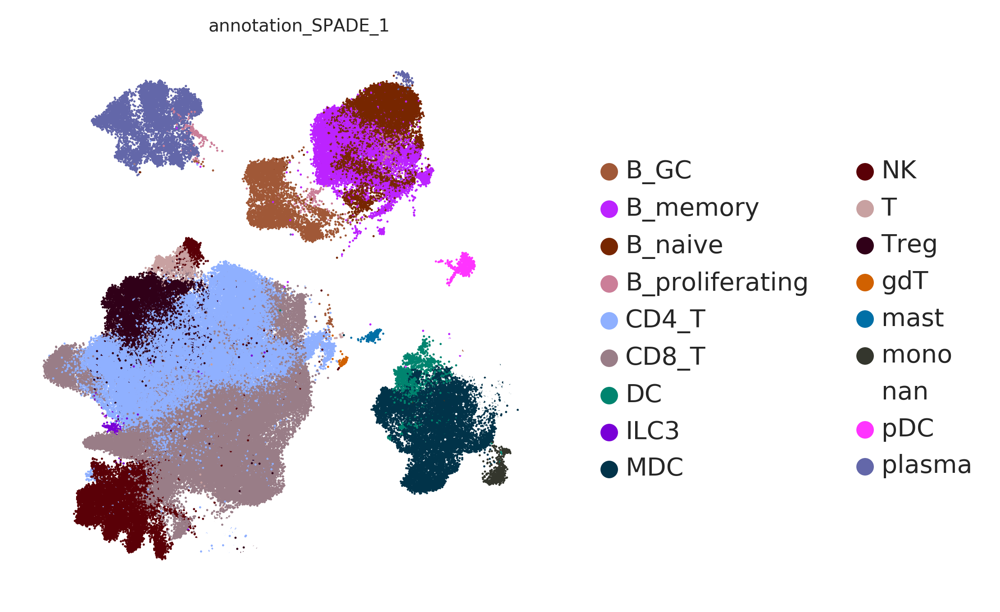

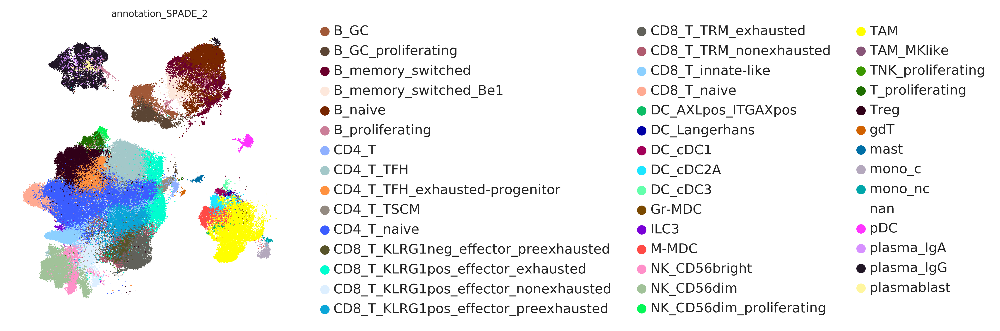

In [25]:
sc.pl.umap(adata, color = ['annotation_SPADE_1'], s = 3, palette=subtype_color_dict, legend_fontsize = 10, vmin=0)
sc.pl.umap(adata, color = ['annotation_SPADE_2'], s = 3, palette=subtype_color_dict, legend_fontsize = 10, vmin=0)

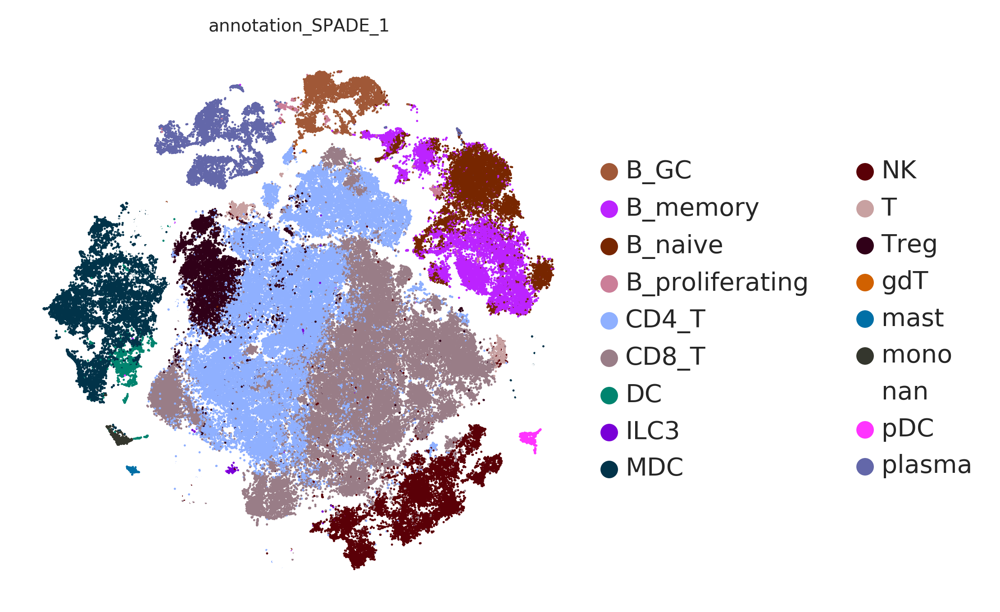

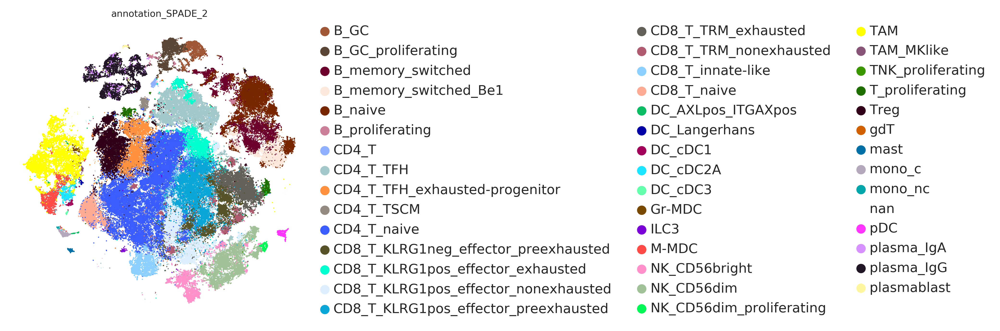

KeyError: 'low_quality_cell'

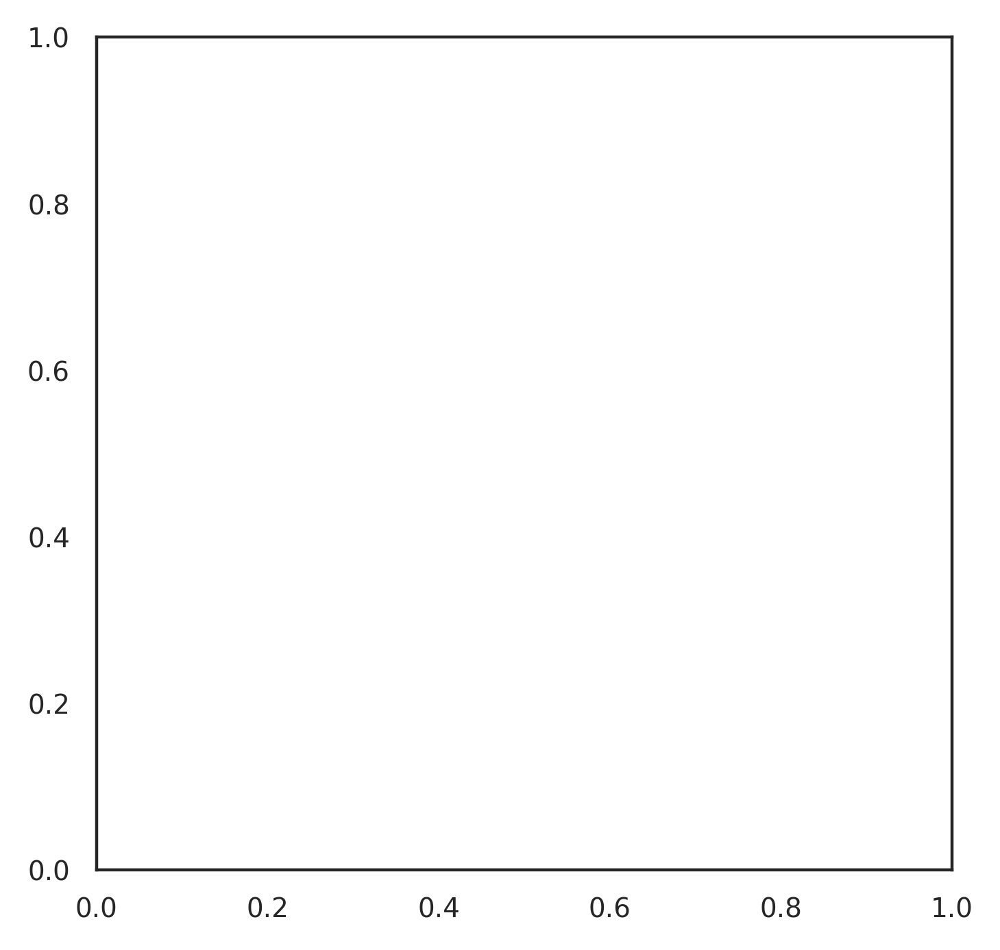

In [26]:
sc.pl.tsne(adata, color = ['annotation_SPADE_1'], s = 3, palette=subtype_color_dict, legend_fontsize = 10, vmin=0)
sc.pl.tsne(adata, color = ['annotation_SPADE_2'], s = 3, palette=subtype_color_dict, legend_fontsize = 10, vmin=0)
sc.pl.tsne(adata, color = ['low_quality_cell'], s = 3, palette=color_map_clusters_nogrey, legend_fontsize = 10, vmin=0)

In [29]:
adata[adata.obs['annotation_SPADE_1']!='nan']

/home/wallet/miniconda3/envs/2021_Peer_SPADE_sample_data_exploration/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2630: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


View of AnnData object with n_obs × n_vars = 150985 × 20237
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'patient_id', 'biomaterial', 'timepoint', 'site', 'age', 'PD-L1_IC_Ventana', 'TIL', 'T', 'N', 'M', 'treatment', 'RECIST', 'biopsied_lesion_size', '8w_biopsied_lesion', 'target_lesion_size', '8w_target_lesion', 'PFS', 'last_follow_up', 'pheno_k10', 'pheno_k20', 'pheno_k30', 'pheno_k40', 'pheno_k50', 'pheno_k60', 'pheno_k70', 'pheno_k80', 'pheno_k90', 'pheno_k100', 'annotation_SPADE_1', 'annotation_SPADE_2'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'neighbors', 'pca', 'umap', 'annotation_SPADE_1_colors', 'annotation_SPADE_2_colors'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    layers: 'imputed'
    obsp: 'conn

In [ ]:
adata

In [18]:
adata

View of AnnData object with n_obs × n_vars = 100444 × 19984
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'batch', 'cohort', 'total_molecules', 'ID', 'age_rounded_up', 'postmenopause', 'TNM_version', 'T_prefix', 'T', 'T_suffix', 'N_prefix', 'N', 'N_suffix', 'M_prefix', 'M', 'M_suffix', 'HER2', 'ER', 'PR', 'CTX', 'KI67_precent_range_prePD1', 'KI67_precent_range_postPD1', 'TCR_clonotype_expansion', 'Bassez_nCount_RNA', 'Bassez_nFeature_RNA', 'Bassez_patient_id', 'Bassez_timepoint', 'Bassez_expansion', 'Bassez_BC_type', 'Bassez_cellType', 'Bassez_cellSubType', 'n_genes', 'percent_mito', 'n_counts', 'doublets', 'major_subsets', 'pheno_k10', 'pheno_k20', 'pheno_k30', 'pheno_k40', 'pheno_k50', 'pheno_k60', 'pheno_k70', 'pheno_k80', 'pheno_k90', 'pheno_k100', 'pheno_var_k10', 'phe

In [27]:
adata.write(adata_save_path)
print('adata saved to:', adata_save_path)

adata saved to: /data/peer/wallet/Jupyter/2021_SPADE/2021_Zhang_BRCA/TIL-X-BRCA-X-Zhang-X-2021-X-all_cells_raw_annotated_clustered_nodrops_nodoub_tumor_scran_labeled_clustered_annotated_211208.h5ad


In [239]:
dense_matrix = adata_full.raw.X.todense()

In [241]:
dense_matrix.max()

42853.0

In [14]:
DATA_DIR

'/data/peer/wallet/Jupyter/2021_SPADE/2021_Zhang_BRCA/'

# Remove nan (=doublets) and recalculate embeddings

In [23]:
#paths
adata_path = DATA_DIR + 'TIL-X-BRCA-X-Zhang-X-2021-X-all_cells_raw_annotated_clustered_nodrops_nodoub_tumor_scran_labeled_clustered_annotated_211208.h5ad'
adata_save_path = DATA_DIR + 'TIL-X-BRCA-X-Zhang-X-2021-X-all_cells_raw_annotated_clustered_nodrops_nodoub_tumor_scran_labeled_clustered_annotated_211208_removed-doublets.h5ad'

In [24]:
#paths
adata_path = DATA_DIR + 'TIL-X-BRCA-X-Zhang-X-2021-X-all_cells_raw_annotated_clustered_nodrops_nodoub_tumor_scran_labeled_clustered_annotated_211208.h5ad'
adata_save_path = DATA_DIR + 'TIL-X-BRCA-X-Zhang-X-2021-X-all_cells_raw_annotated_clustered_nodrops_nodoub_tumor_scran_labeled_clustered_annotated_211208_removed-doublets.h5ad'

In [11]:
adata = sc.read(adata_path)
adata

AnnData object with n_obs × n_vars = 160416 × 20237
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'patient_id', 'biomaterial', 'timepoint', 'site', 'age', 'PD-L1_IC_Ventana', 'TIL', 'T', 'N', 'M', 'treatment', 'RECIST', 'biopsied_lesion_size', '8w_biopsied_lesion', 'target_lesion_size', '8w_target_lesion', 'PFS', 'last_follow_up', 'pheno_k10', 'pheno_k20', 'pheno_k30', 'pheno_k40', 'pheno_k50', 'pheno_k60', 'pheno_k70', 'pheno_k80', 'pheno_k90', 'pheno_k100', 'annotation_SPADE_1', 'annotation_SPADE_2'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'annotation_SPADE_1_colors', 'annotation_SPADE_2_colors', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    layers: 'imputed'
    obsp: 'connectiviti

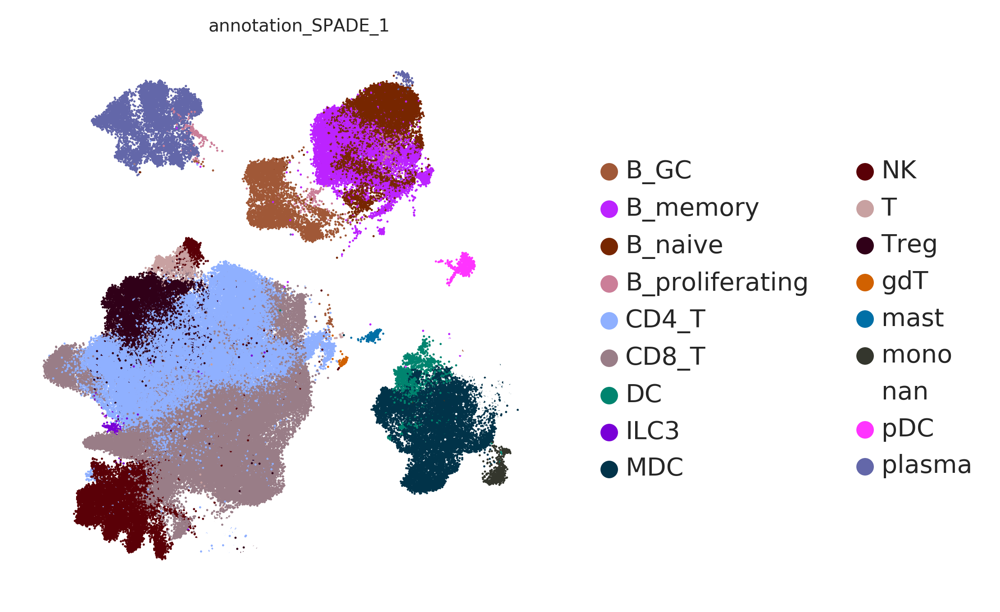

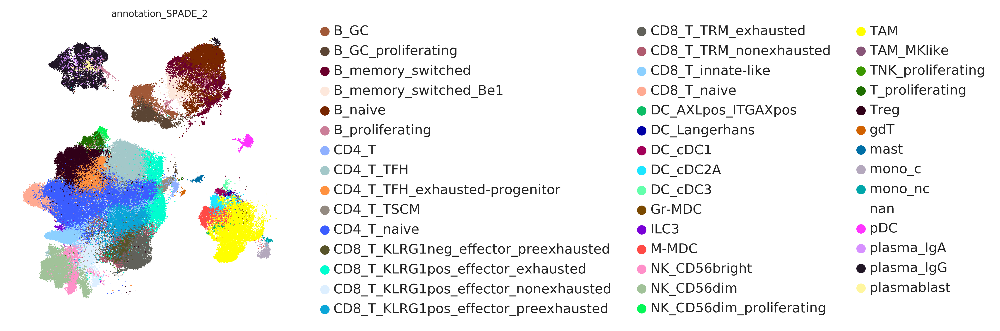

In [14]:
sc.pl.umap(adata, color = ['annotation_SPADE_1'], s = 3, palette=subtype_color_dict, legend_fontsize = 10, vmin=0)
sc.pl.umap(adata, color = ['annotation_SPADE_2'], s = 3, palette=subtype_color_dict, legend_fontsize = 10, vmin=0)


In [15]:
adata

AnnData object with n_obs × n_vars = 160416 × 20237
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'patient_id', 'biomaterial', 'timepoint', 'site', 'age', 'PD-L1_IC_Ventana', 'TIL', 'T', 'N', 'M', 'treatment', 'RECIST', 'biopsied_lesion_size', '8w_biopsied_lesion', 'target_lesion_size', '8w_target_lesion', 'PFS', 'last_follow_up', 'pheno_k10', 'pheno_k20', 'pheno_k30', 'pheno_k40', 'pheno_k50', 'pheno_k60', 'pheno_k70', 'pheno_k80', 'pheno_k90', 'pheno_k100', 'annotation_SPADE_1', 'annotation_SPADE_2'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'annotation_SPADE_1_colors', 'annotation_SPADE_2_colors', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    layers: 'imputed'
    obsp: 'connectiviti

In [19]:
#remove nan
adata = adata[adata.obs['annotation_SPADE_1']!='nan']

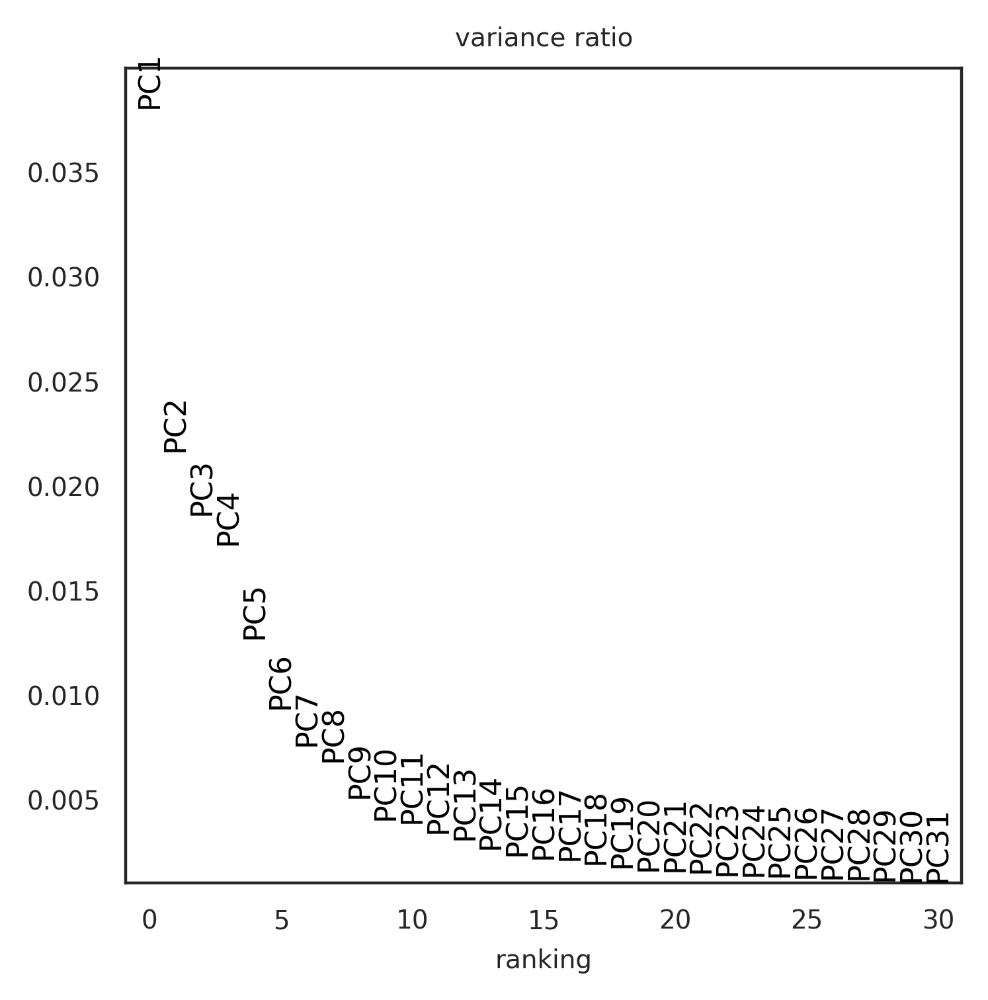

In [20]:
#recalculate PCs
sc.tl.pca(adata, svd_solver='arpack',n_comps=100) 
sc.pl.pca_variance_ratio(adata,log=False)

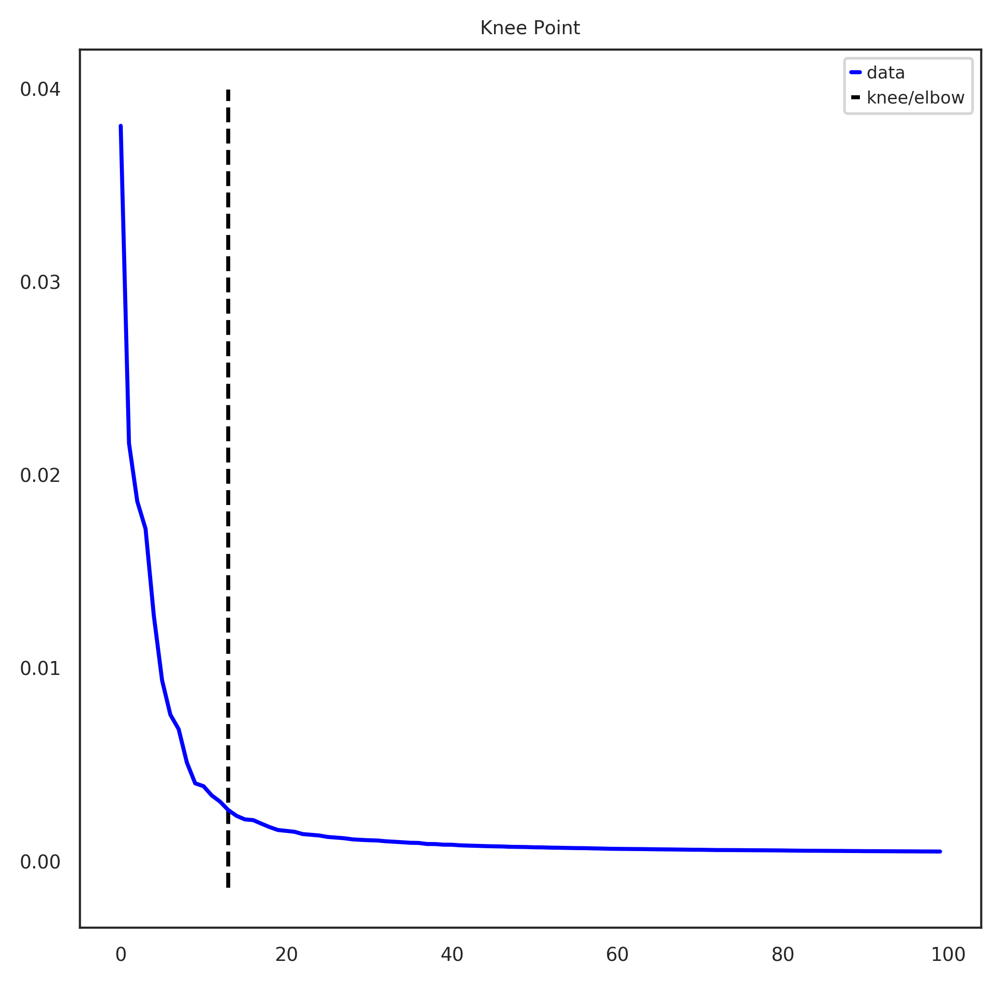

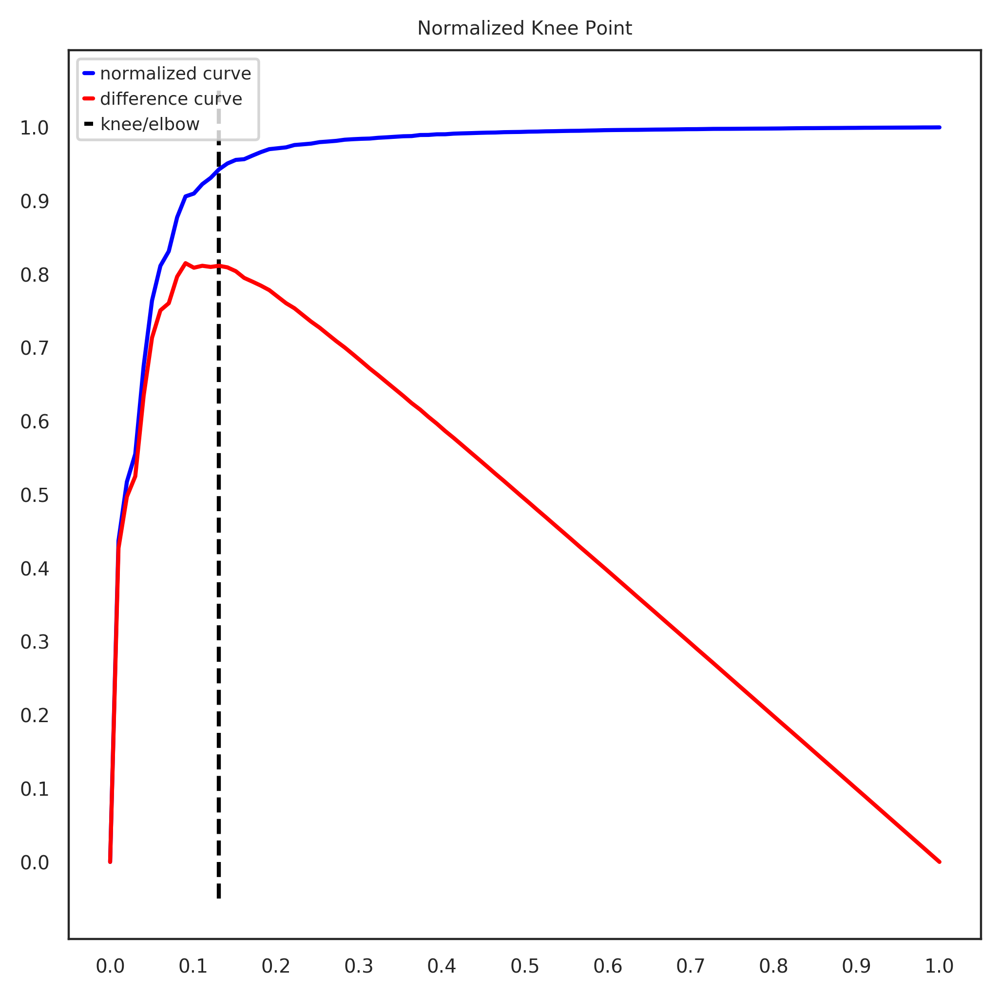

Kneepoint happens at PC: 13
13 PC explain 15.152961683537521 % of variance


In [21]:
a = adata.copy()# PCs kneepoint
x = [i for i in range(len(a.uns["pca"]["variance_ratio"]))]
y = list(a.uns["pca"]["variance_ratio"])
kneedle = KneeLocator(x,
                      y,
                      S=1,
                      curve='convex',
                      direction='decreasing',
                      online=False)
kn_pc = round(kneedle.knee, 3)
kneedle.plot_knee()
plt.show()
kneedle.plot_knee_normalized()
plt.show()
print("Kneepoint happens at PC:", kn_pc)

exp_var = sum(adata.uns['pca']['variance_ratio'][:kn_pc])
exp_var_test_percent = exp_var*100
print(kn_pc,'PC explain',exp_var_test_percent, '% of variance')


In [25]:
#find number of PCs explaining at least 20% of variance
tested_PC_number = kn_pc

while exp_var_test_percent <20:
    tested_PC_number = tested_PC_number+1
    exp_var_test = sum(adata.uns['pca']['variance_ratio'][0:tested_PC_number])
    exp_var_test_percent = exp_var_test*100
    print(tested_PC_number, 'PC explain',exp_var_test_percent, '% of variance')
    if tested_PC_number == 100:
        break
        print('ended loop, 100 PC reached')

14 PC explain 15.417493332616445 % of variance
15 PC explain 15.65217060350386 % of variance
16 PC explain 15.868470217359143 % of variance
17 PC explain 16.081098666462076 % of variance
18 PC explain 16.27515356171618 % of variance
19 PC explain 16.45150110683442 % of variance
20 PC explain 16.612860308840002 % of variance
21 PC explain 16.769709712099093 % of variance
22 PC explain 16.921861404467663 % of variance
23 PC explain 17.062058060176838 % of variance
24 PC explain 17.198762991876077 % of variance
25 PC explain 17.33171468704967 % of variance
26 PC explain 17.457153118144124 % of variance
27 PC explain 17.579427637181666 % of variance
28 PC explain 17.698216388844607 % of variance
29 PC explain 17.811265563105465 % of variance
30 PC explain 17.921657544920745 % of variance
31 PC explain 18.03004130623406 % of variance
32 PC explain 18.137159375247975 % of variance
33 PC explain 18.24032960886344 % of variance
34 PC explain 18.341092087035364 % of variance
35 PC explain 18.43

In [26]:
#set number of components according to kneepoint and explained variance
n_comps = tested_PC_number
print('number of PCs for clusterings/embeddings is:', n_comps)

number of PCs for clusterings/embeddings is: 55


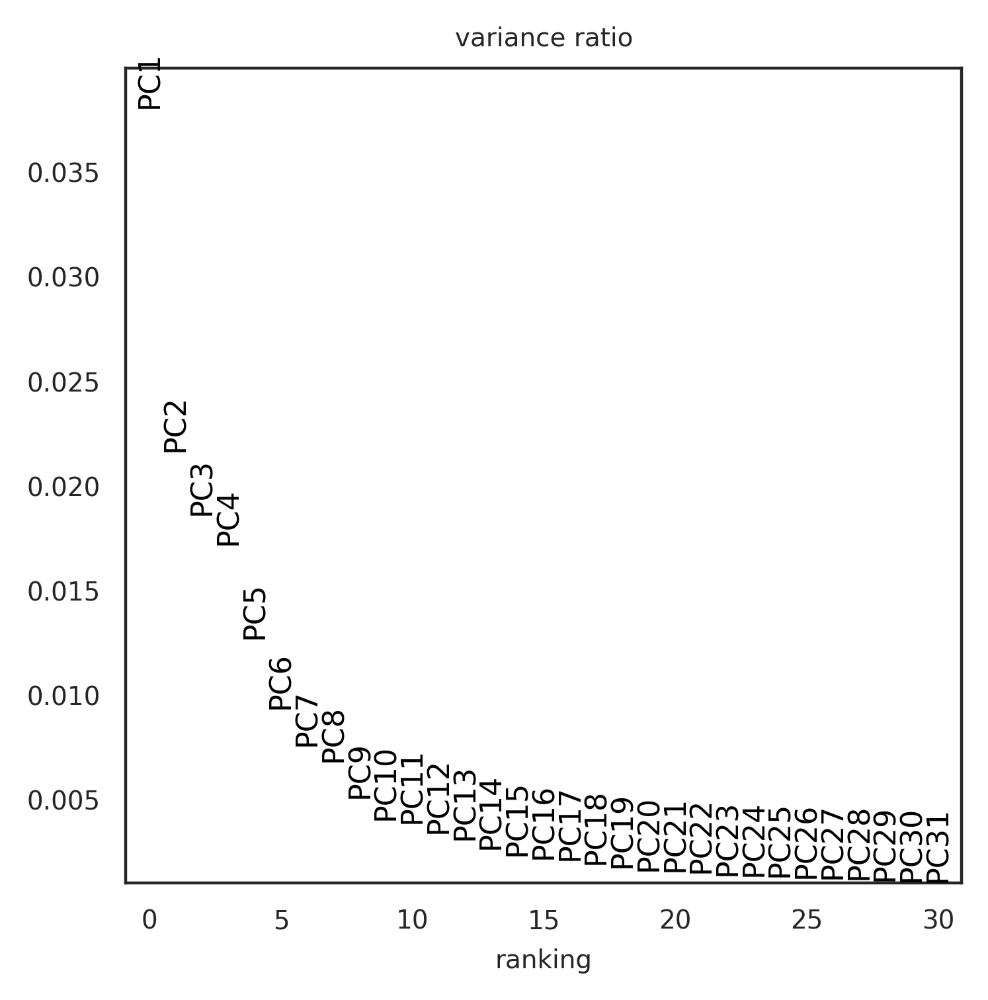

In [27]:
sc.tl.pca(adata, svd_solver='arpack',n_comps=n_comps) 
sc.pl.pca_variance_ratio(adata,log=False)

In [28]:
sc.pp.neighbors(adata, n_neighbors=10, method= 'umap', n_pcs=n_comps)
sc.tl.umap(adata)

In [29]:
sc.tl.tsne(adata, random_state = 7)

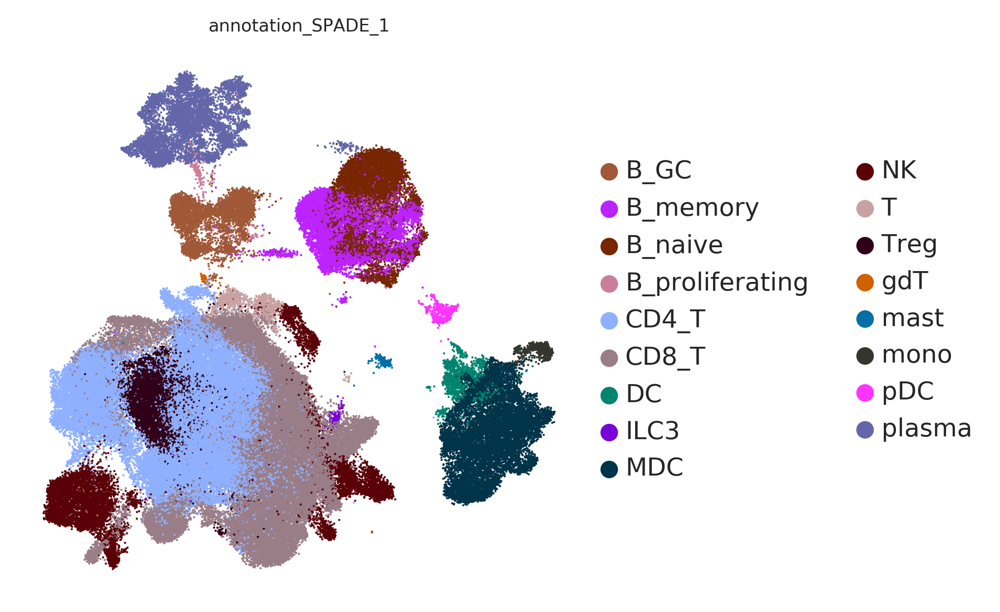

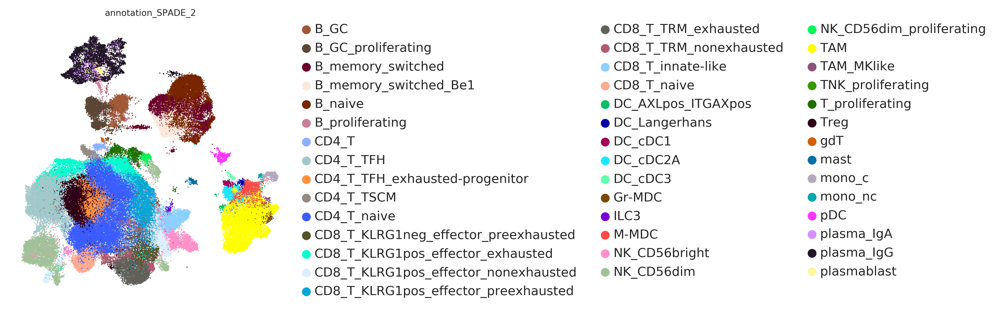

In [30]:
sc.pl.umap(adata, color = ['annotation_SPADE_1'], s = 3, palette=subtype_color_dict, legend_fontsize = 10, vmin=0)
sc.pl.umap(adata, color = ['annotation_SPADE_2'], s = 3, palette=subtype_color_dict, legend_fontsize = 10, vmin=0)

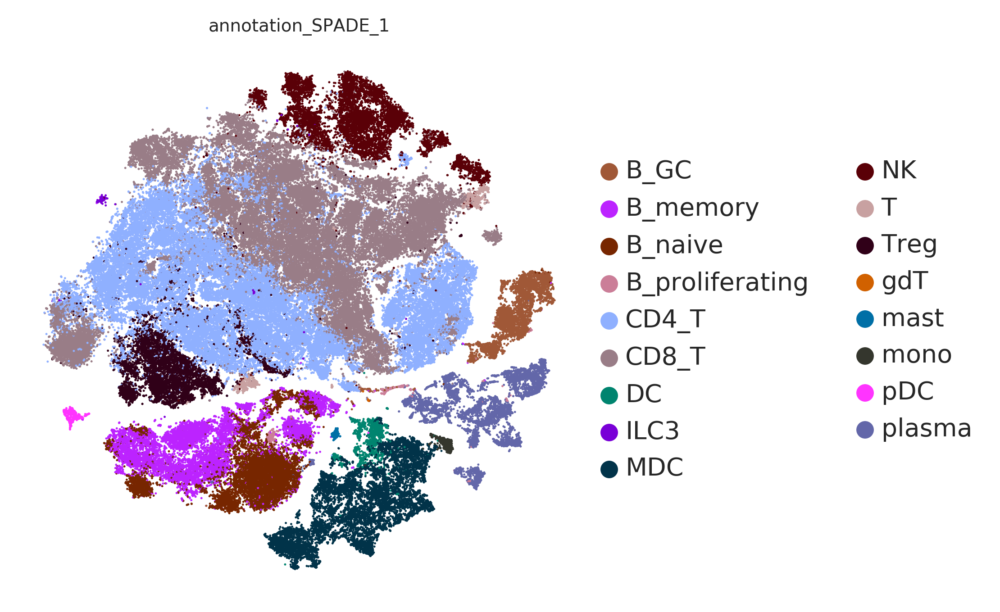

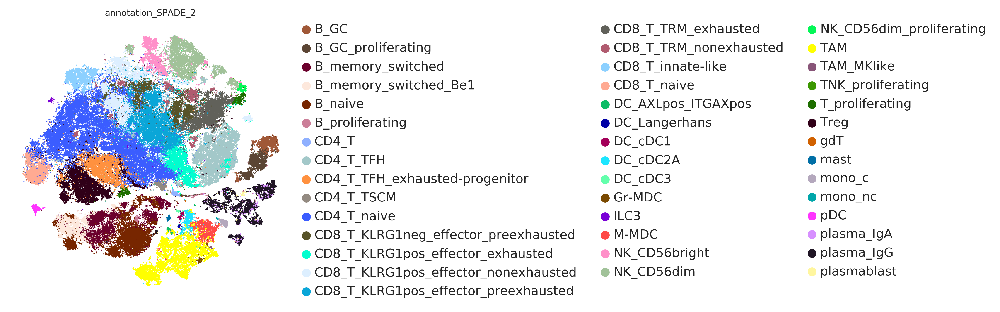

In [31]:
sc.pl.tsne(adata, color = ['annotation_SPADE_1'], s = 3, palette=subtype_color_dict, legend_fontsize = 10, vmin=0)
sc.pl.tsne(adata, color = ['annotation_SPADE_2'], s = 3, palette=subtype_color_dict, legend_fontsize = 10, vmin=0)

In [100]:
map_dict = {'B_GC':'B',
 'B_memory':'B',
 'B_naive':'B',
 'B_proliferating':'B',
 'CD4_T':'TNK',
 'CD8_T':'TNK',
 'DC':'M',
 'ILC3':'TNK',
 'MDC':'M',
 'NK':'TNK',
 'T':'TNK',
 'Treg':'TNK',
 'gdT':'TNK',
 'mast':'M',
 'mono':'M',
 'pDC':'M',
 'plasma':'B',}

adata.obs['annotation_SPADE_0'] = adata.obs['annotation_SPADE_1'].map(map_dict)

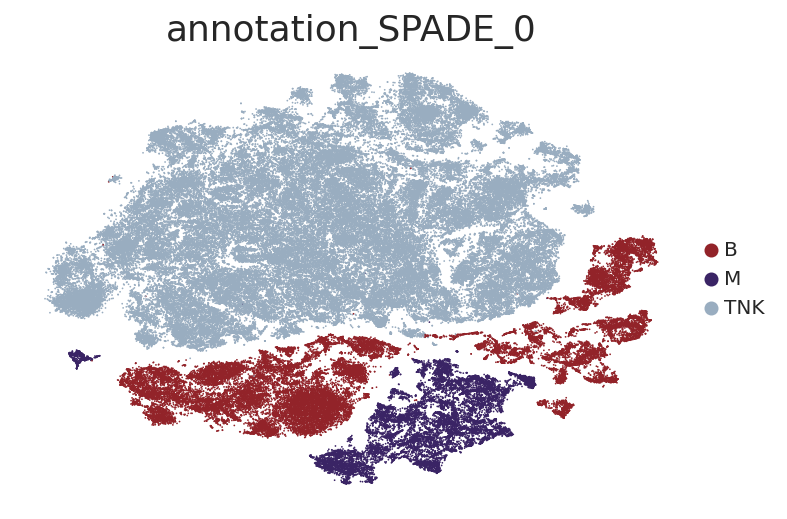

In [101]:
sc.pl.tsne(adata, color = ['annotation_SPADE_0'], s = 3, palette=subtype_color_dict, legend_fontsize = 10, vmin=0)

In [32]:
adata.write(adata_save_path)
print('adata saved to:', adata_save_path)

adata saved to: /data/peer/wallet/Jupyter/2021_SPADE/2021_Zhang_BRCA/TIL-X-BRCA-X-Zhang-X-2021-X-all_cells_raw_annotated_clustered_nodrops_nodoub_tumor_scran_labeled_clustered_annotated_211208_removed-doublets.h5ad


In [33]:
#force directed layout
sc.tl.draw_graph(adata, layout='fa', init_pos=None, root=None, random_state=0, n_jobs=None, adjacency=None, key_added_ext=None, neighbors_key=None, obsp=None, copy=False)

In [34]:
#diffusion components
sc.tl.diffmap(adata, n_comps=15, neighbors_key=None, copy=False)

In [35]:
adata.write(adata_save_path)
print('adata saved to:', adata_save_path)

adata saved to: /data/peer/wallet/Jupyter/2021_SPADE/2021_Zhang_BRCA/TIL-X-BRCA-X-Zhang-X-2021-X-all_cells_raw_annotated_clustered_nodrops_nodoub_tumor_scran_labeled_clustered_annotated_211208_removed-doublets.h5ad


# marker genes

In [10]:
adata_path = '/data/peer/wallet/Jupyter/SPADE_Peer_validation/data_final/TIL-X-BRCA-X-Zhang-X-2021-X-all_cells_raw_annotated_clustered_nodrops_nodoub_tumor_scran_labeled_clustered_annotated_211208_removed-doublets_graph0.01_delta_0.001_beta_0.0_pseudo_0.0_new.h5ad'


In [11]:
adata = sc.read(adata_path)
adata

Only considering the two last: ['.0_new', '.h5ad'].
Only considering the two last: ['.0_new', '.h5ad'].


AnnData object with n_obs × n_vars = 150985 × 20237
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'patient_id', 'biomaterial', 'timepoint', 'site', 'age', 'PD-L1_IC_Ventana', 'TIL', 'T', 'N', 'M', 'treatment', 'RECIST', 'biopsied_lesion_size', '8w_biopsied_lesion', 'target_lesion_size', '8w_target_lesion', 'PFS', 'last_follow_up', 'pheno_k10', 'pheno_k20', 'pheno_k30', 'pheno_k40', 'pheno_k50', 'pheno_k60', 'pheno_k70', 'pheno_k80', 'pheno_k90', 'pheno_k100', 'annotation_SPADE_1', 'annotation_SPADE_2', '0-X-all_multidrug-resistance', '1-X-all_porphyrine-heme_metabolism', '2-X-all_TNF-via-NFkB_signaling', '3-X-all_glyoxylate-dicarboxylate_metabolism', '4-X-all_IL6-JAK-STAT3_signaling', '5-X-all_fatty-acid-beta-oxidation-peroxisomal', '6-X-all_triacylglycerol_synthesis', '7-X-all_circadian-rhythm', '8-X-all_heparan-sul

In [12]:
#load cellular identity markers
marker_df_path = '/data/peer/wallet/Jupyter/SPADE_Peer_validation/SPECTRA_celltypes_x_genesets_x_versions_x_genes.csv'
cell_type_marker_df = pd.read_csv(marker_df_path)
cell_type_marker_df

,c.name,gs.name,v.id,g.name,g.ENSEMBL
0,T,T_UP,v_hs317,CD3E,ENSG00000198851
1,T,T_UP,v_hs317,CD3D,ENSG00000167286
2,T,T_UP,v_hs317,CD3G,ENSG00000160654
3,B,B_UP,v_hs318,CD79A,ENSG00000105369
4,B,B_UP,v_hs318,CD79B,ENSG00000007312
...,...,...,...,...,...
601,CD4-T,T_CD4-T_UP,v_hs309,IL21,ENSG00000138684
602,CD4-T,T_CD4-T_UP,v_hs309,IL17B,ENSG00000127743
603,CD4-T,T_CD4-T_UP,v_hs309,CD40LG,ENSG00000102245
604,CD4-T,T_CD4-T_UP,v_hs309,ICOS,ENSG00000163600


In [13]:
set(cell_type_marker_df['c.name'])

{'B',
 'B-memory',
 'B-memory-DN',
 'B-memory-IgM-MZ',
 'B-memory-non-switched',
 'B-memory-switched',
 'B-naive',
 'B-pb-mature',
 'B-pb-t1',
 'B-pb-t2',
 'CD4-T',
 'CD56bright-NK',
 'CD56dim-NK',
 'CD8-T',
 'CD8-T-progenitor-exhausted',
 'CD8-T_KLRG1neg-effector',
 'CD8-T_KLRG1pos-effector',
 'CD8-T_terminal-exhaustion',
 'FDC',
 'GC-B',
 'ILC1',
 'ILC2',
 'ILC3-NCRneg',
 'ILC3-NCRpos',
 'Langerhans',
 'Lti',
 'Mac',
 'NK',
 'NK-adaptive',
 'T',
 'T-naive',
 'TCM',
 'TEM',
 'TFH',
 'TRM',
 'TSCM',
 'Treg',
 'cDC1',
 'cDC2',
 'cDC3',
 'capillary',
 'endo-aerocyte',
 'endo-systemic-venous',
 'gdT',
 'gran',
 'lung-endo-venous',
 'mast',
 'mo-DC',
 'mono',
 'p-DC',
 'plasma',
 'plasma-blast'}

In [14]:
set(adata.obs['annotation_SPADE_2'])

{'B_GC',
 'B_GC_proliferating',
 'B_memory_switched',
 'B_memory_switched_Be1',
 'B_naive',
 'B_proliferating',
 'CD4_T',
 'CD4_T_TFH',
 'CD4_T_TFH_exhausted-progenitor',
 'CD4_T_TSCM',
 'CD4_T_naive',
 'CD8_T_KLRG1neg_effector_preexhausted',
 'CD8_T_KLRG1pos_effector_exhausted',
 'CD8_T_KLRG1pos_effector_nonexhausted',
 'CD8_T_KLRG1pos_effector_preexhausted',
 'CD8_T_TRM_exhausted',
 'CD8_T_TRM_nonexhausted',
 'CD8_T_innate-like',
 'CD8_T_naive',
 'DC_AXLpos_ITGAXpos',
 'DC_Langerhans',
 'DC_cDC1',
 'DC_cDC2A',
 'DC_cDC3',
 'Gr-MDC',
 'ILC3',
 'M-MDC',
 'NK_CD56bright',
 'NK_CD56dim',
 'NK_CD56dim_proliferating',
 'TAM',
 'TAM_MKlike',
 'TNK_proliferating',
 'T_proliferating',
 'Treg',
 'gdT',
 'mast',
 'mono_c',
 'mono_nc',
 'pDC',
 'plasma_IgA',
 'plasma_IgG',
 'plasmablast'}

In [15]:
#extract cell types of interest

celltype_gs = ['T','CD8-T','CD4-T','Treg','gdT', 'NK','ILC3-NCRpos','B', 'B-naive','B-memory','GC-B','plasma','plasma-blast','p-DC','cDC1','cDC2','cDC3','Langerhans',
        'mo-DC','FDC','mono','Mac', 'gran', 'mast']

cell_type_marker_df_subset = cell_type_marker_df[cell_type_marker_df['c.name'].isin(celltype_gs)]

#create dictionary 

marker_dict = {}

for i in set(cell_type_marker_df_subset['c.name']):
    marker_dict[i] = list(cell_type_marker_df_subset[cell_type_marker_df_subset['c.name']==i]['g.name'])

marker_dict

{'CD4-T': ['TRAC',
  'TRBC2',
  'TRBC1',
  'IL17A',
  'RORC',
  'IL6',
  'CD4',
  'BCL6',
  'IL21',
  'IL17B',
  'CD40LG',
  'ICOS',
  'GATA3'],
 'mast': ['KIT',
  'TPSB2',
  'ENPP3',
  'MS4A2',
  'TPSD1',
  'PTGDR',
  'GATA2',
  'HDC',
  'IL1RL1',
  'TPSAB1'],
 'NK': ['KLRK1',
  'NCR3',
  'IL12RB1',
  'KLRF1',
  'NCAM1',
  'EOMES',
  'NCR1',
  'KLRG1',
  'TBX21'],
 'gran': ['CXCR2',
  'CSF3R',
  'ACOD1',
  'CEACAM8',
  'FFAR4',
  'MPO',
  'CD24',
  'CTSG',
  'FUT4',
  'LTF',
  'CXCR1',
  'FCGR3B',
  'VASP',
  'ELANE',
  'AZU1'],
 'ILC3-NCRpos': ['KLRB1',
  'IL23R',
  'AHR',
  'KIT',
  'IL1R2',
  'RORC',
  'ICOS',
  'IL7R',
  'TNFSF11',
  'NCR2'],
 'plasma': ['IL6ST',
  'IL6RA',
  'ZBTB20',
  'TNFRSF17',
  'IRF4',
  'PRDM1',
  'XBP1',
  'ENPP1',
  'IL6R',
  'HLA-DMA',
  'AICDA',
  'HLA-DRB3',
  'HLA-DOB',
  'HLA-DQB1',
  'HLA-DRB4',
  'HLA-DPB1',
  'SDC1',
  'HLA-DMB',
  'CD38',
  'MKI67',
  'CD27',
  'HLA-DQA1',
  'HLA-DRA',
  'SLAMF7',
  'HLA-DPA1'],
 'Langerhans': ['CDH1',
  'EPCAM'

In [16]:
marker_dict['plasma-blast']

['XBP1',
 'IL6RA',
 'ZBTB20',
 'TNFRSF17',
 'IL6ST',
 'CXCR4',
 'IRF4',
 'HLA-DPB1',
 'HLA-DQB1',
 'HLA-DQA1',
 'HLA-DRA',
 'HLA-DPA1',
 'CD27',
 'HLA-DMB',
 'MKI67',
 'HLA-DRB4',
 'HLA-DMA',
 'HLA-DRB3',
 'HLA-DOB',
 'CD38',
 'SLAMF7']

In [47]:
set(adata.obs['annotation_SPADE_1'])

{'B_GC',
 'B_memory',
 'B_naive',
 'B_proliferating',
 'CD4_T',
 'CD8_T',
 'DC',
 'ILC3',
 'MDC',
 'NK',
 'T',
 'Treg',
 'gdT',
 'mast',
 'mono',
 'pDC',
 'plasma'}

In [50]:
marker_dict_clean['Mac']

['MARCO', 'CD36', 'MSR1', 'CD68', 'APOE', 'MRC1', 'CD163']

In [53]:
list_small = ['CD19','MS4A1','CD79A','CD79B','AICDA','BCL6','SDC1','IGHG1','IGHA1','IGHE','IGHD','IGHM',
             'CD3E','CD3G','CD3D','TRAC','TRBC1','TRBC2','TRGC','TRDC','CD8A','CD8B','CD4','FOXP3','IL2RA','ITGAX',
              'ID2','IRF4','IRF8','IRF7','TCF4','CLEC4A','BATF3','XCR1',
             'KIT','NCR1','NCAM1','PRF1','TPSAB1','TPSB2','S100A8','S100A9','CD14','CD68','MARCO','CD36','APOE']

list_small = list(set([x for x in list_small if x in adata.var_names]))

In [17]:
#filter dict for genes not contained in the data

marker_dict_clean = OrderedDict()

for i in celltype_gs:
        marker_dict_clean[i] = [x for x in marker_dict[i] if x in adata.var_names]

In [20]:
marker_list_clean = []

for i,v in marker_dict_clean.items():
    marker_list_clean = marker_list_clean+ v
marker_list_clean = list(set(marker_list_clean))
marker_list_clean

['IL23A',
 'SELL',
 'TRDC',
 'IL21',
 'HLA-DOB',
 'TRGC2',
 'TCF3',
 'NCAM1',
 'FCGR3B',
 'ACOD1',
 'AZU1',
 'EOMES',
 'TNFRSF17',
 'PTGDR',
 'TGFB1',
 'TGFB2',
 'CADM1',
 'FCGR1B',
 'HLA-DPB1',
 'CD79A',
 'CD207',
 'ENTPD1',
 'CD24',
 'CD8A',
 'FCER1A',
 'XCR1',
 'TPSD1',
 'S100A8',
 'LTA',
 'CR1',
 'IL15',
 'TLR4',
 'MFGE8',
 'S100A9',
 'IL12B',
 'KLRF1',
 'CTSG',
 'XBP1',
 'HLA-DQB1',
 'KLF4',
 'BCL6',
 'TNFRSF18',
 'IRF8',
 'ENPP3',
 'GATA3',
 'CXCL16',
 'LAMP3',
 'BTLA',
 'CD86',
 'APOE',
 'NCR3',
 'FUT4',
 'THBD',
 'TGFBR1',
 'IL2RA',
 'SLAMF7',
 'KLRB1',
 'KLRK1',
 'TCF4',
 'TNFRSF9',
 'CTLA4',
 'CCL22',
 'FCER1G',
 'BATF3',
 'CR2',
 'GZMA',
 'MSR1',
 'MAFB',
 'ICOS',
 'CLEC10A',
 'CCR7',
 'TGFBR2',
 'CD40LG',
 'ZEB2',
 'HLA-DMB',
 'CD1C',
 'CD38',
 'CD8B',
 'AHR',
 'CD79B',
 'CD19',
 'HDC',
 'TRGC1',
 'CXCL9',
 'HLA-DPA1',
 'TRBC1',
 'PRDM1',
 'RUNX3',
 'IRF7',
 'LILRA2',
 'CSF3R',
 'TNFSF11',
 'TGFBR3',
 'NOTCH2',
 'CLEC4C',
 'NRP1',
 'CD3G',
 'CD3D',
 'MKI67',
 'FCGR2B',
 'IL

In [56]:
fontscale=1
pheno_heat = 'annotation_SPADE_1'

sc.pl.dotplot(adata,list_small , groupby=pheno_heat, standard_scale='var',
            return_fig=False , save='Zhang_markers_basic.svg')

In [88]:
row_order = [  'T_proliferating',
              'TNK_proliferating',
             'CD8_T_KLRG1pos_effector_nonexhausted',
              'CD8_T_KLRG1pos_effector_preexhausted',
              'CD8_T_KLRG1pos_effector_exhausted',
            'CD8_T_KLRG1neg_effector_preexhausted',
 'CD8_T_TRM_exhausted',
 'CD8_T_TRM_nonexhausted',
 'CD8_T_innate-like',
 'CD8_T_naive',
    'CD4_T',
 'CD4_T_TFH',
 'CD4_T_TFH_exhausted-progenitor',
 'CD4_T_TSCM',
     'CD4_T_naive',
     'Treg',
              'gdT',
              'ILC3',
              'NK_CD56bright',
 'NK_CD56dim',
 'NK_CD56dim_proliferating',
              'B_proliferating',
     'B_naive',
     'B_memory_switched',
 'B_memory_switched_Be1',
             'B_GC',
              'B_GC_proliferating',
 'plasma_IgA',
 'plasma_IgG',
 'plasmablast', 'pDC',
              'DC_cDC1',
 'DC_cDC2A',
 'DC_cDC3', 
              'DC_Langerhans',
 'DC_AXLpos_ITGAXpos',
              'mono_c',
 'mono_nc',
              'M-MDC',
              'TAM',
 'TAM_MKlike', 'Gr-MDC', 'mast']

In [89]:
set(adata.obs['annotation_SPADE_2'])

{'B_GC',
 'B_GC_proliferating',
 'B_memory_switched',
 'B_memory_switched_Be1',
 'B_naive',
 'B_proliferating',
 'CD4_T',
 'CD4_T_TFH',
 'CD4_T_TFH_exhausted-progenitor',
 'CD4_T_TSCM',
 'CD4_T_naive',
 'CD8_T_KLRG1neg_effector_preexhausted',
 'CD8_T_KLRG1pos_effector_exhausted',
 'CD8_T_KLRG1pos_effector_nonexhausted',
 'CD8_T_KLRG1pos_effector_preexhausted',
 'CD8_T_TRM_exhausted',
 'CD8_T_TRM_nonexhausted',
 'CD8_T_innate-like',
 'CD8_T_naive',
 'DC_AXLpos_ITGAXpos',
 'DC_Langerhans',
 'DC_cDC1',
 'DC_cDC2A',
 'DC_cDC3',
 'Gr-MDC',
 'ILC3',
 'M-MDC',
 'NK_CD56bright',
 'NK_CD56dim',
 'NK_CD56dim_proliferating',
 'TAM',
 'TAM_MKlike',
 'TNK_proliferating',
 'T_proliferating',
 'Treg',
 'gdT',
 'mast',
 'mono_c',
 'mono_nc',
 'pDC',
 'plasma_IgA',
 'plasma_IgG',
 'plasmablast'}

saved Figure to: Zhang_allcells_markers_dotplot_220819.svg


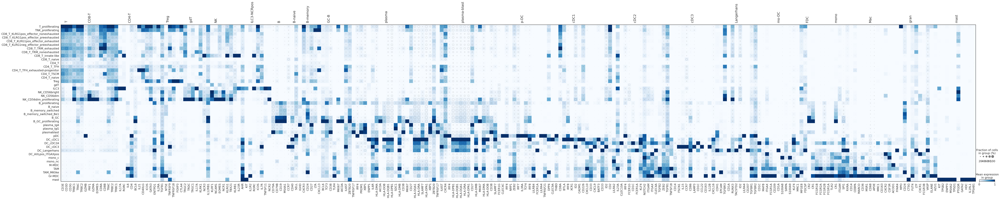

In [94]:
#dotplot
%matplotlib inline
save_name = 'Zhang_allcells_markers_dotplot_220819.svg'
pheno_heat = 'annotation_SPADE_2'
adata_plot = adata
sns.set(font_scale = 1.5)
sns.set_style('white')
dp = sc.pl.dotplot(adata_plot, marker_dict_clean, groupby=pheno_heat, standard_scale='var',
             categories_order = row_order,return_fig=True,save=save_name).style(color_on='square', cmap='Blues',
                                                                )
dp.savefig(save_name)
print('saved Figure to:',save_name)